In [670]:
import cv2
import json
import types
import random
import pickle
import builtins
import numpy as np
import pandas as pd
from glob import glob
from PIL import Image
import scipy.ndimage as ndimage
import matplotlib.pyplot as plt

In [671]:
def imports():
    for name, val in globals().items():
        # module imports
        if isinstance(val, types.ModuleType):
            yield name, val

            # functions / callables
        if hasattr(val, '__call__'):
            yield name, val


def noglobal(f):
    '''
    ref: https://gist.github.com/raven38/4e4c3c7a179283c441f575d6e375510c
    '''
    return types.FunctionType(f.__code__,
                              dict(imports()),
                              f.__name__,
                              f.__defaults__,
                              f.__closure__
                              )



In [13]:
path_list = sorted(glob('./../data_ignore/input/metadata/*/*/*.png'))

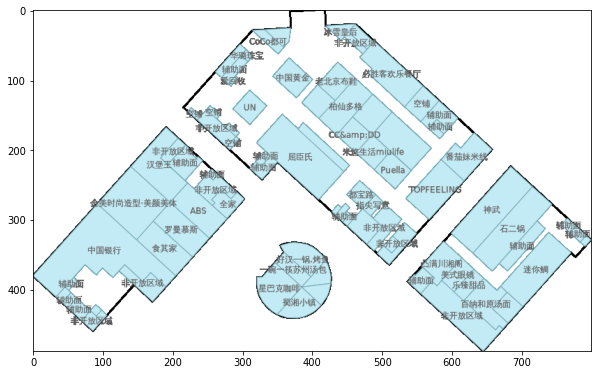

In [390]:
idx = 109
img_ori = cv2.imread(path_list[idx], -1)
logics = np.where(img_ori[:, :, 3] == 0)
img_ori[logics] = [255, 255, 255, 255]
img = img_ori.copy()
img_ori = cv2.cvtColor(img_ori, cv2.COLOR_BGR2RGB)
img = cv2.cvtColor(img, cv2.COLOR_BGRA2GRAY)
# img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
# img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # RGB2〜 でなく BGR2〜 を指定

fig = plt.figure(figsize=(10, 10))
fig.patch.set_facecolor('white')
plt.imshow(img_ori)
plt.show()

<br>

thresholdで２値化

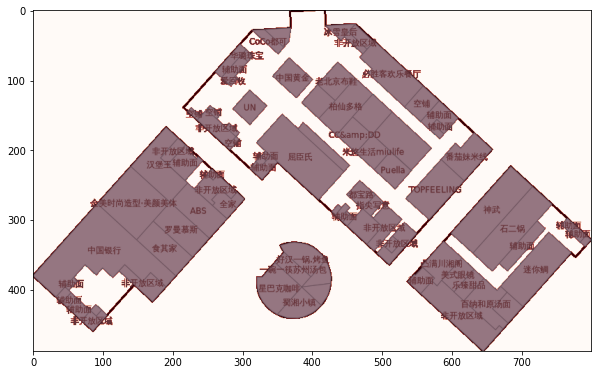

In [391]:
# thre = 50
thre = 230
thre, region = cv2.threshold(img, thre, 1, cv2.THRESH_BINARY_INV)

fig = plt.figure(figsize=(10, 10))
fig.patch.set_facecolor('white')
plt.imshow(img_ori)
plt.imshow(region, cmap="Reds", alpha=0.5)
# cv2.
plt.show()

<br>

モルフォロジー変換

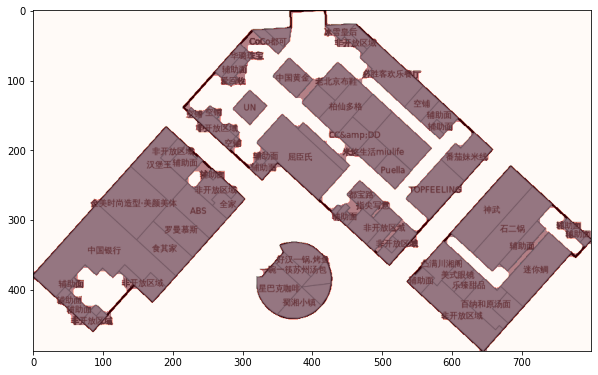

In [392]:
s = 10
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (s, s))
region_mor = cv2.morphologyEx(region, cv2.MORPH_CLOSE, kernel)
# region_mor = cv2.morphologyEx(region, cv2.MORPH_ELLIPSE, kernel)
# region_mor = cv2.morphologyEx(region_mor, cv2.MORPH_ELLIPSE, kernel)
# region_mor = cv2.morphologyEx(region_mor, cv2.MORPH_, kernel)

fig = plt.figure(figsize=(10, 10))
fig.patch.set_facecolor('white')
plt.imshow(img_ori)
plt.imshow(region_mor, cmap="Reds", alpha=0.5)

<br>

穴埋め

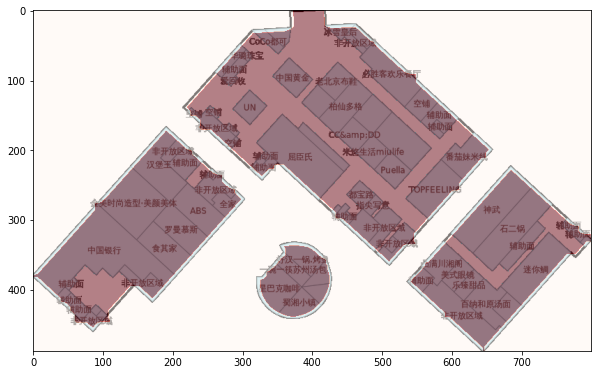

In [518]:
# region_fill = region_mor.copy()
region_fill = ndimage.binary_fill_holes(region_mor).astype(np.uint8)

# ちょっと内側に狭める
s = 10
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (s, s))
region_fill = cv2.morphologyEx(region_fill, cv2.MORPH_ERODE, kernel)

_region = region_fill

fig = plt.figure(figsize=(10, 10))
fig.patch.set_facecolor('white')
plt.imshow(img_ori)
plt.imshow(_region, cmap="Reds", alpha=0.5)

<br>

通路を取得する
1. 白い領域の取得
2. 取得した建物内との交差領域を取得

<br>

1. 画像内の白い領域を取得

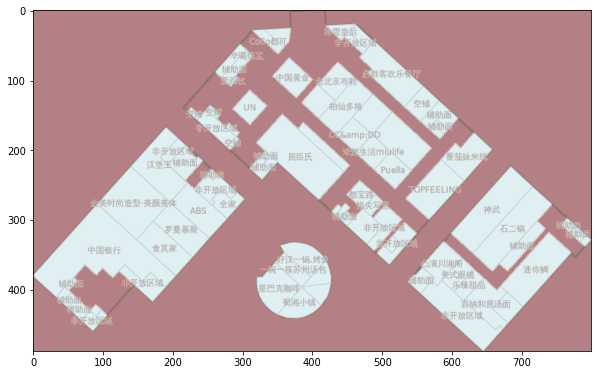

In [519]:
thre = 230
thre, region_white = cv2.threshold(img, thre, 1, cv2.THRESH_BINARY)

_region = region_white

fig = plt.figure(figsize=(10, 10))
fig.patch.set_facecolor('white')
plt.imshow(img_ori)
plt.imshow(_region, cmap="Reds", alpha=0.5)

<br>

2. 取得した建物内との交差領域を取得

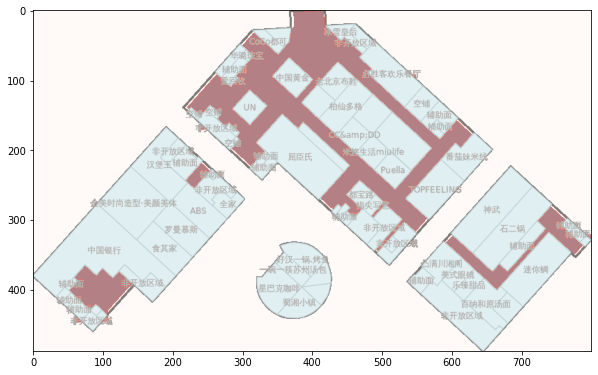

In [537]:
region_road = region_white & region_fill

_region = region_road

fig = plt.figure(figsize=(10, 10))
fig.patch.set_facecolor('white')
plt.imshow(img_ori)
plt.imshow(_region, cmap="Reds", alpha=0.5)

---> 通路が取得できた!!

<br>

通路に等間隔に点を打つ

In [588]:
h, w = img.shape
x, y = np.meshgrid(np.linspace(0, w, w), np.linspace(0, h, h))
z = np.zeros_like(x).astype(int)

step = 13
x_arr = np.arange(0, w, step).astype(int)
y_arr = np.arange(0, h, step).astype(int)

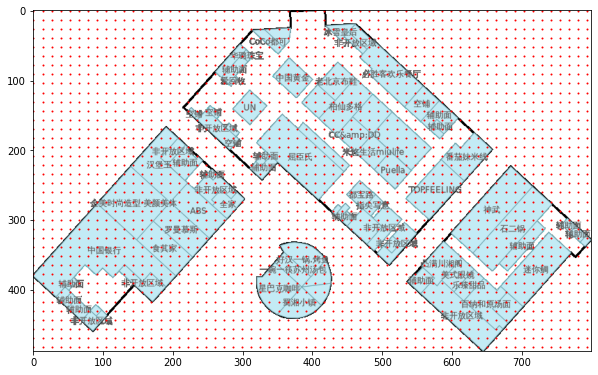

In [589]:
for _x in x_arr:
    for _y in y_arr:
        z[_y, _x] = 1
# region_extra_grid[region_road==0] = 0
_x = np.ravel(x)[np.ravel(z)==1]
_y = np.ravel(y)[np.ravel(z)==1]

_region = region_extra_grid

fig = plt.figure(figsize=(10, 10))
fig.patch.set_facecolor('white')
plt.imshow(img_ori)
# plt.imshow(_region, cmap='Reds', alpha=0.5)
plt.scatter(_x, _y, color='r', s=1)

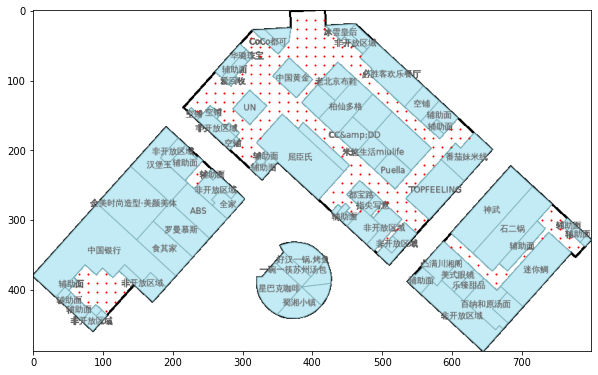

In [590]:
for _x in x_arr:
    for _y in y_arr:
        z[_y, _x] = 1
region_extra_grid = (z==region_road)
region_extra_grid[region_road==0] = 0
_x = np.ravel(x)[np.ravel(region_extra_grid)]
_y = np.ravel(y)[np.ravel(region_extra_grid)]

_region = region_extra_grid

fig = plt.figure(figsize=(10, 10))
fig.patch.set_facecolor('white')
plt.imshow(img_ori)
# plt.imshow(_region, cmap='Reds', alpha=0.5)
plt.scatter(_x, _y, color='r', s=1)

# まとめてみる

In [742]:
path_list[0]

'./../data_ignore/input/metadata/5a0546857ecc773753327266/B1/floor_image.png'

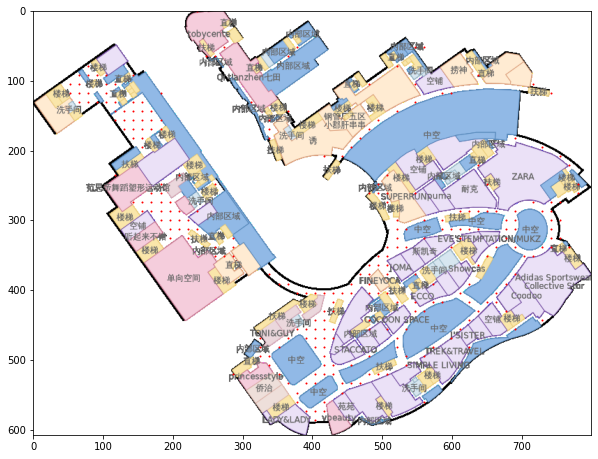

In [763]:
fig = plt.figure(figsize=(10, 10))
fig.patch.set_facecolor('white')

# 画像のロード
idx = 7
img_ori = cv2.imread(path_list[idx], -1)
logics = np.where(img_ori[:, :, 3] == 0)
img_ori[logics] = [255, 255, 255, 255]
img = img_ori.copy()
img_ori = cv2.cvtColor(img_ori, cv2.COLOR_BGR2RGB)
img = cv2.cvtColor(img, cv2.COLOR_BGRA2GRAY)
plt.imshow(img_ori)
# plt.imshow(img, cmap='gray')

############
# 通路の取得 #
############
# 2値化
thre = 230
thre, region = cv2.threshold(img, thre, 1, cv2.THRESH_BINARY_INV)

# closing
s = 10
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (s, s))
region_mor = cv2.morphologyEx(region, cv2.MORPH_CLOSE, kernel)
# plt.imshow(region_mor, cmap="Reds", alpha=0.5)

# すこし内側に収縮させる
# s = 10
# kernel = np.ones((s, s), np.uint8)
# region_mor = cv2.morphologyEx(region_mor, cv2.MORPH_ERODE, kernel)
# plt.imshow(region_mor, cmap="Reds", alpha=0.5)

# 穴埋め
region_fill = ndimage.binary_fill_holes(region_mor).astype(np.uint8)
# plt.imshow(region_fill, cmap="Reds", alpha=0.5)

# すこし内側に収縮させる
# s = 10
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (s, s))
# region_fill = cv2.morphologyEx(region_fill, cv2.MORPH_ERODE, kernel)

###############
# 白い領域の取得 #
###############
thre = 250
thre, region_white = cv2.threshold(img, thre, 1, cv2.THRESH_BINARY)
# plt.imshow(region_white, cmap="Reds", alpha=0.5)

############
# 通路の取得 #
############
region_road = region_white & region_fill

############################
# 画面全体に赤い点を等間隔に打つ #
############################
h, w = img.shape
x, y = np.meshgrid(np.linspace(0, w, w), np.linspace(0, h, h))
z = np.zeros_like(x).astype(int)

step = 13
x_arr = np.arange(0, w, step).astype(int)
y_arr = np.arange(0, h, step).astype(int)

for _x in x_arr:
    for _y in y_arr:
        z[_y, _x] = 1

#####################
# 通路にのみ赤い点を打つ #
#####################
region_extra_grid = (z==region_road)
region_extra_grid[region_road==0] = 0
_x = np.ravel(x)[np.ravel(region_extra_grid)]
_y = np.ravel(y)[np.ravel(region_extra_grid)]

plt.scatter(_x, _y, color='r', s=1)

In [761]:
@noglobal
def get_extra_grid(path_img, width_m, height_m, length_m):

    # 画像のロード
    img_ori = cv2.imread(path_img, -1)
    logics = np.where(img_ori[:, :, 3] == 0)
    img_ori[logics] = [255, 255, 255, 255]
    img_gray = img_ori.copy()
    img_ori = cv2.cvtColor(img_ori, cv2.COLOR_BGR2RGB)
    img_gray = cv2.cvtColor(img_gray, cv2.COLOR_BGRA2GRAY)

    ############
    # 通路の取得 #
    ############
    # 2値化
    thre = 230
    thre, region = cv2.threshold(img_gray, thre, 1, cv2.THRESH_BINARY_INV)

    # closing
    s = 10
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (s, s))
    region_mor = cv2.morphologyEx(region, cv2.MORPH_CLOSE, kernel)

    # すこし内側に収縮させる
    # s = 10
    # kernel = np.ones((s, s), np.uint8)
    # region_mor = cv2.morphologyEx(region_mor, cv2.MORPH_ERODE, kernel)

    # 穴埋め
    region_fill = ndimage.binary_fill_holes(region_mor).astype(np.uint8)

    # すこし内側に収縮させる
    # s = 10
    # kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (s, s))
    # region_fill = cv2.morphologyEx(region_fill, cv2.MORPH_ERODE, kernel)

    ###############
    # 白い領域の取得 #
    ###############
    thre = 250
    thre, region_white = cv2.threshold(img_gray, thre, 1, cv2.THRESH_BINARY)

    ############
    # 通路の取得 #
    ############
    region_road = region_white & region_fill

    ############################
    # 画面全体に赤い点を等間隔に打つ #
    ############################
    h, w = img_gray.shape
    x, y = np.meshgrid(np.linspace(0, w, w), np.linspace(0, h, h))
    z = np.zeros_like(x).astype(int)

    # メートルをpixcel単位に合わせる
    w_length_px = int(w/width_m*length_m)
    h_length_px = int(h/height_m*length_m)
    
    x_arr = np.arange(0, w, w_length_px).astype(int)
    y_arr = np.arange(0, h, h_length_px).astype(int)

    for _x in x_arr:
        for _y in y_arr:
            z[_y, _x] = 1

    #####################
    # 通路にのみ赤い点を打つ #
    #####################
    region_extra_grid = (z==region_road)
    region_extra_grid[region_road==0] = 0
    y = np.flipud(y)
    _x = np.ravel(x)[np.ravel(region_extra_grid)==1]
    _y = np.ravel(y)[np.ravel(region_extra_grid)==1]

    return img_ori, img_gray, _x, _y

# 全siteに適用してみる

In [721]:
sub = pd.read_csv('./../data/nb/002/nb002_sub.csv')
site_path_timestamp = sub.site_path_timestamp.values
site_arr = []
path_arr = []
for val in site_path_timestamp:
    site, path, _ = val.split('_')
    site_arr.append(site)
    path_arr.append(path)
site_arr = np.array(site_arr)
path_arr = np.array(path_arr)

In [722]:
dir_image = './../data_ignore/input/metadata/'
site_unique = sorted(np.unique(site_arr))

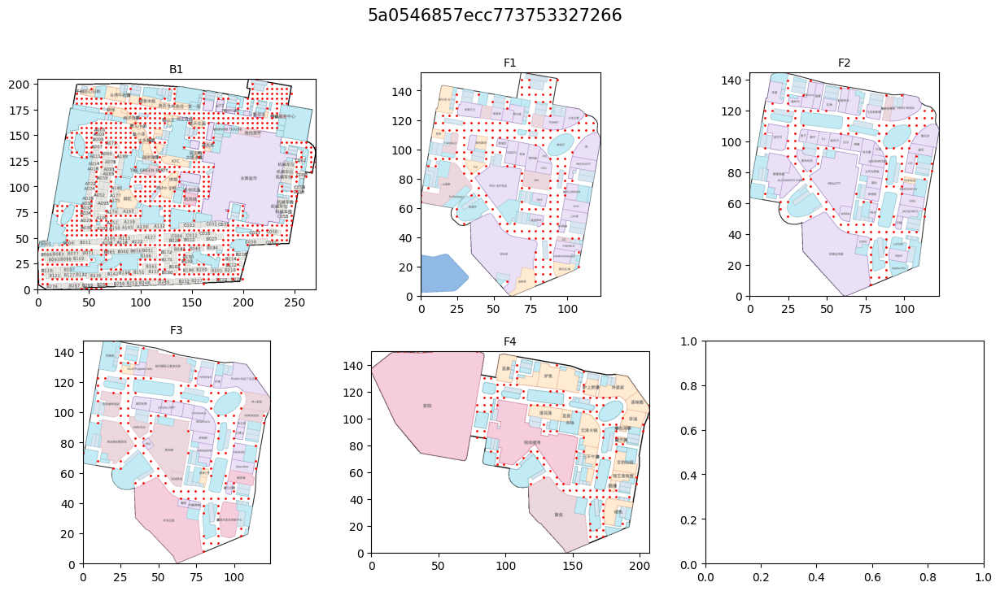

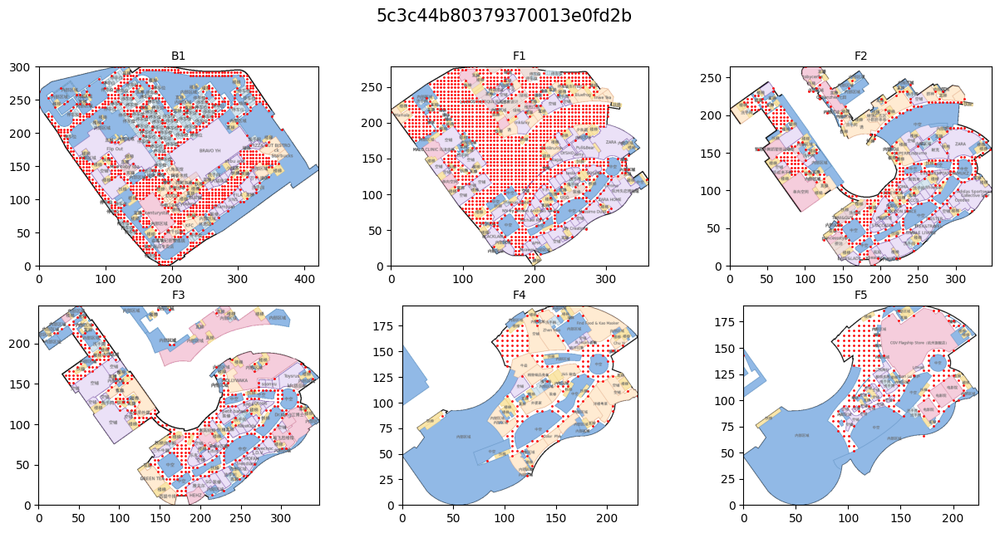

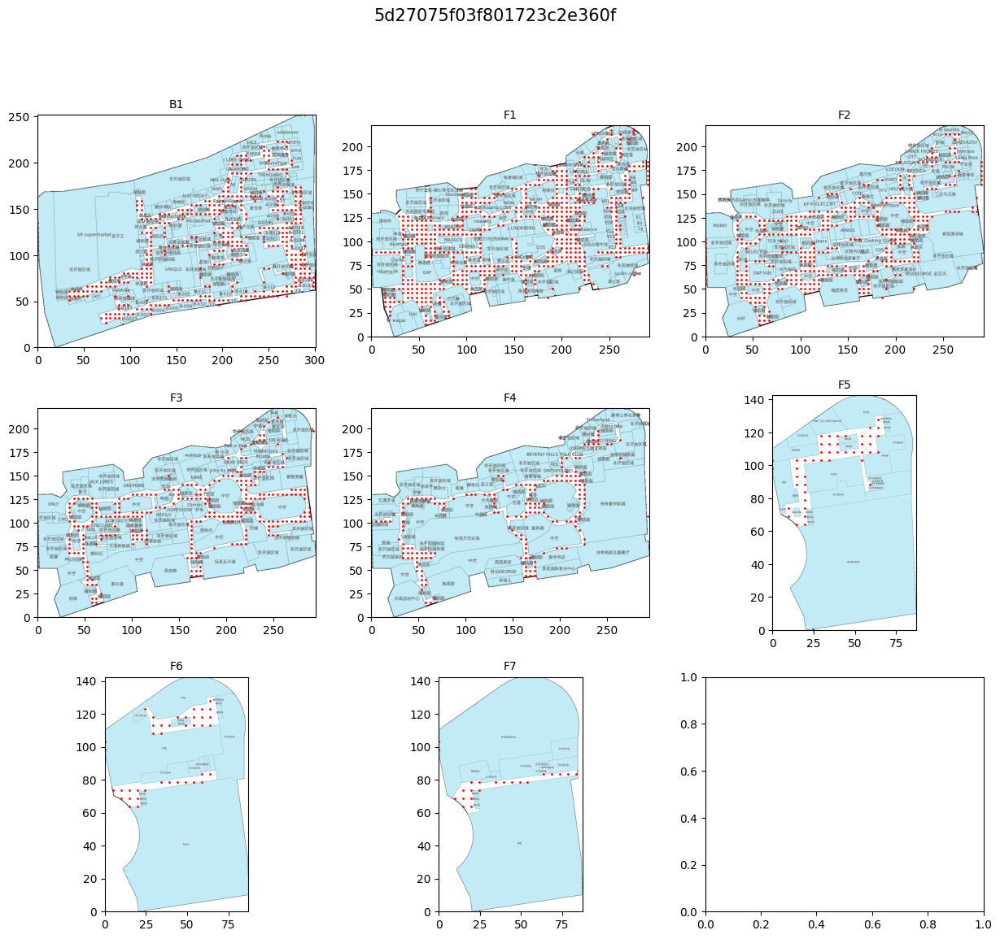

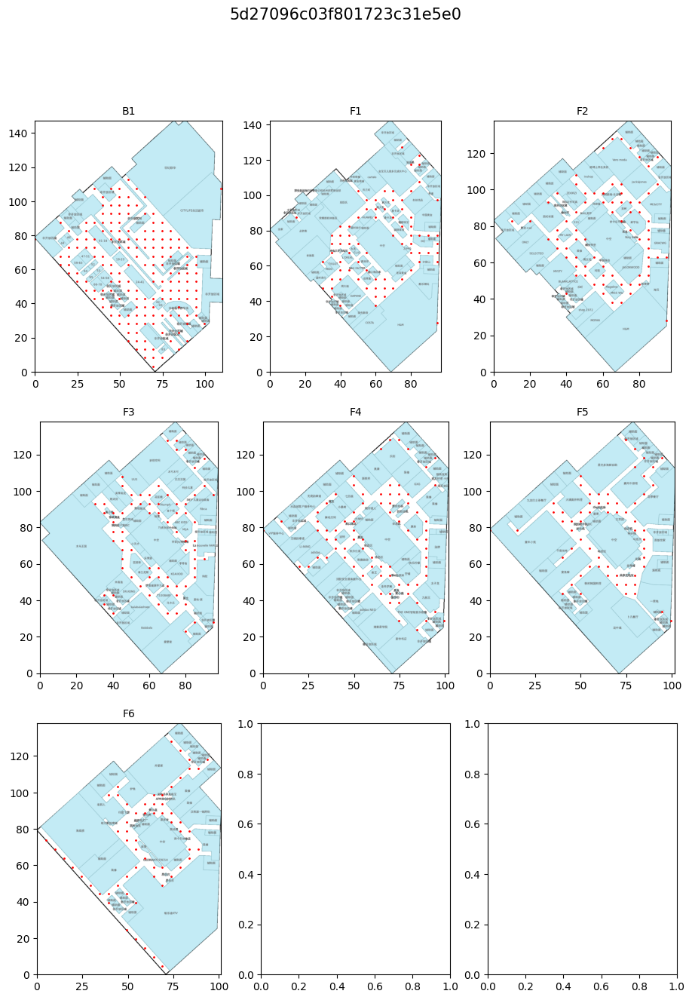

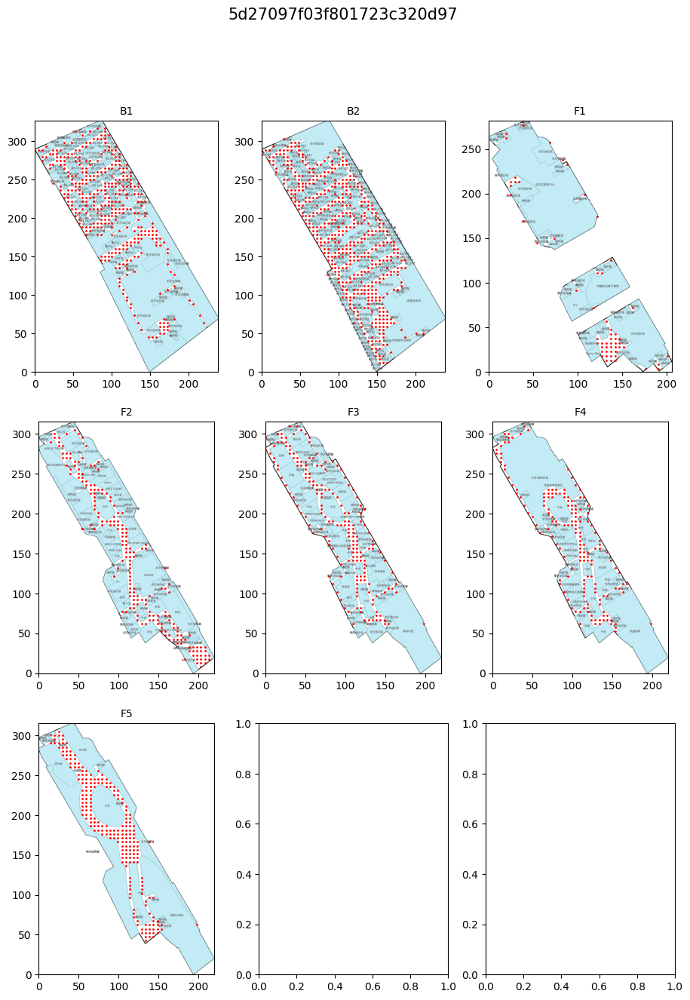

...

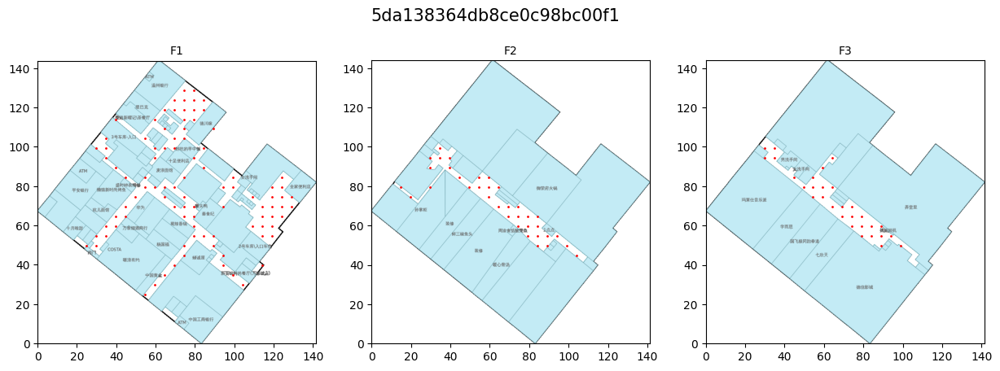

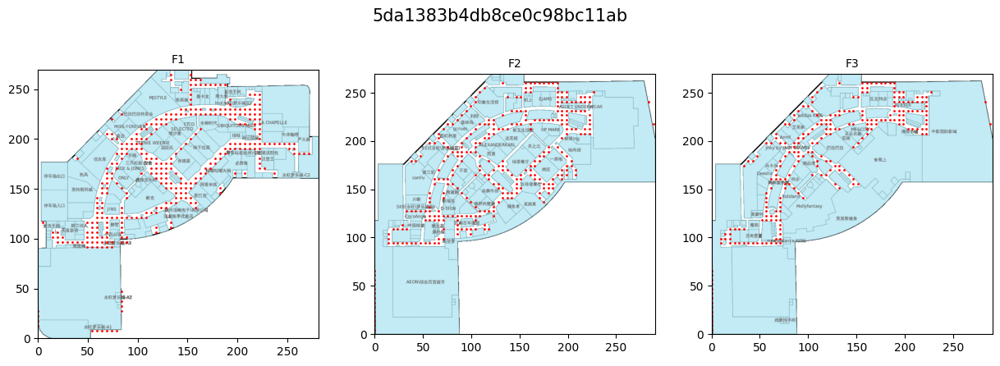

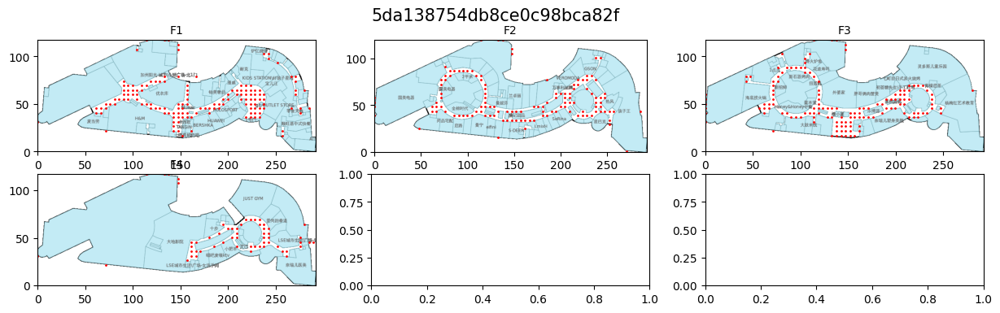

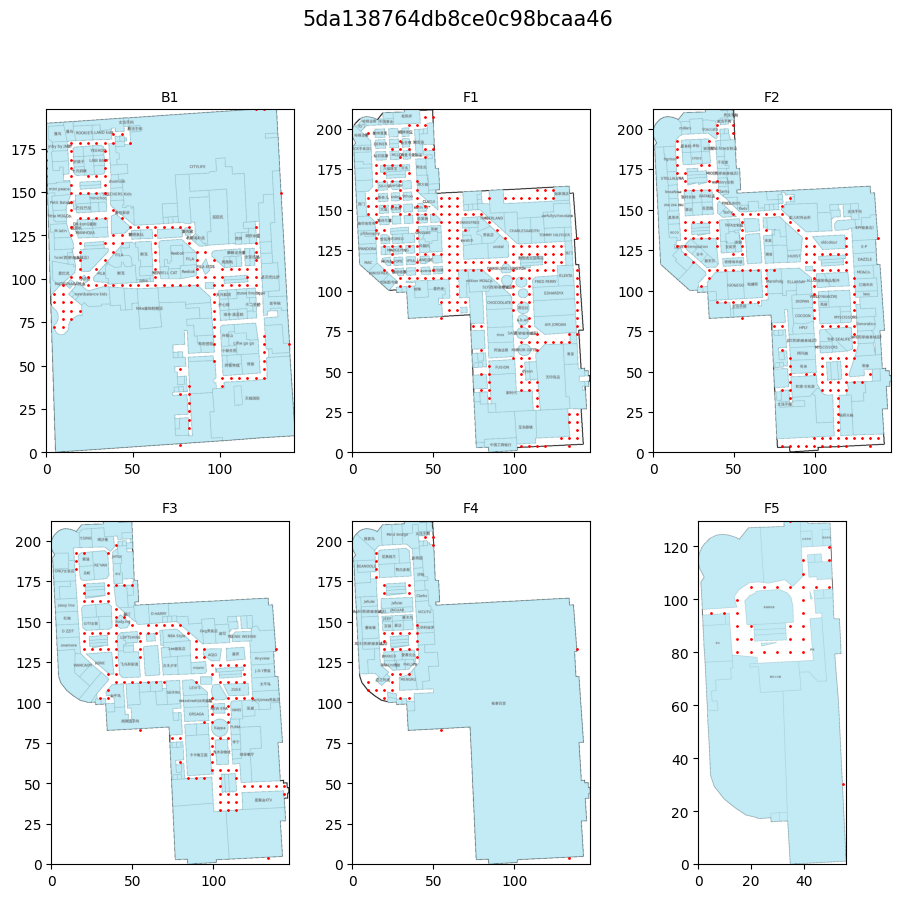

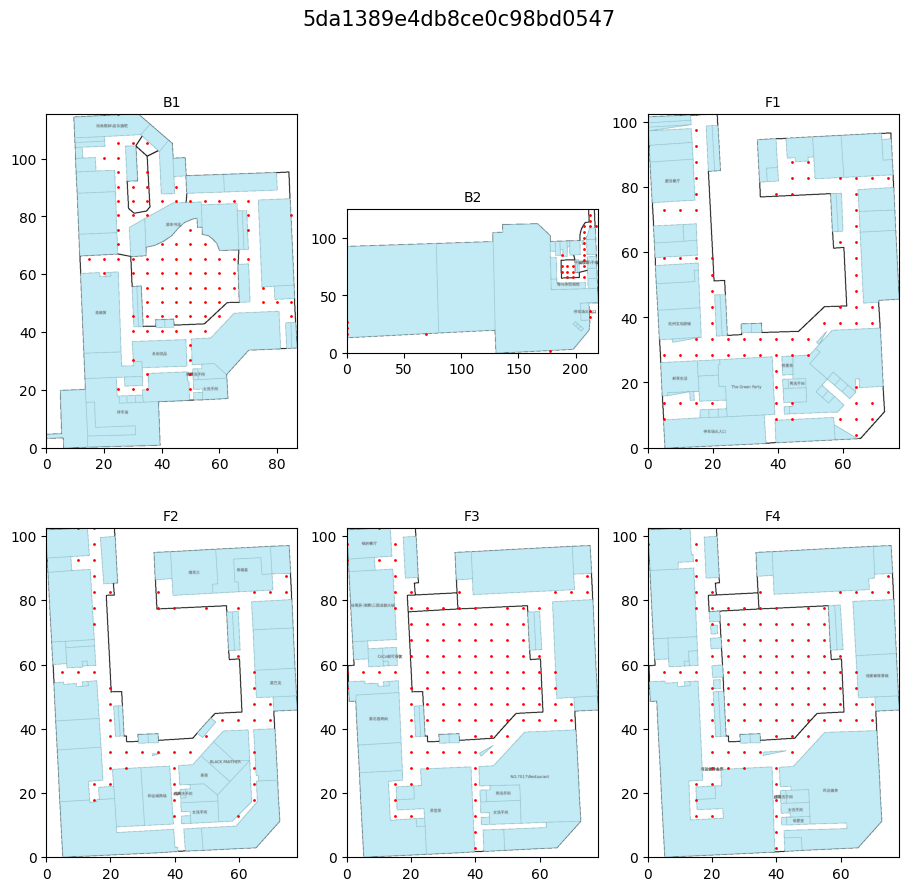

<ipython-input-764-042ece9d4d26>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(n_row, 3, figsize=(w, h), dpi=dpi)


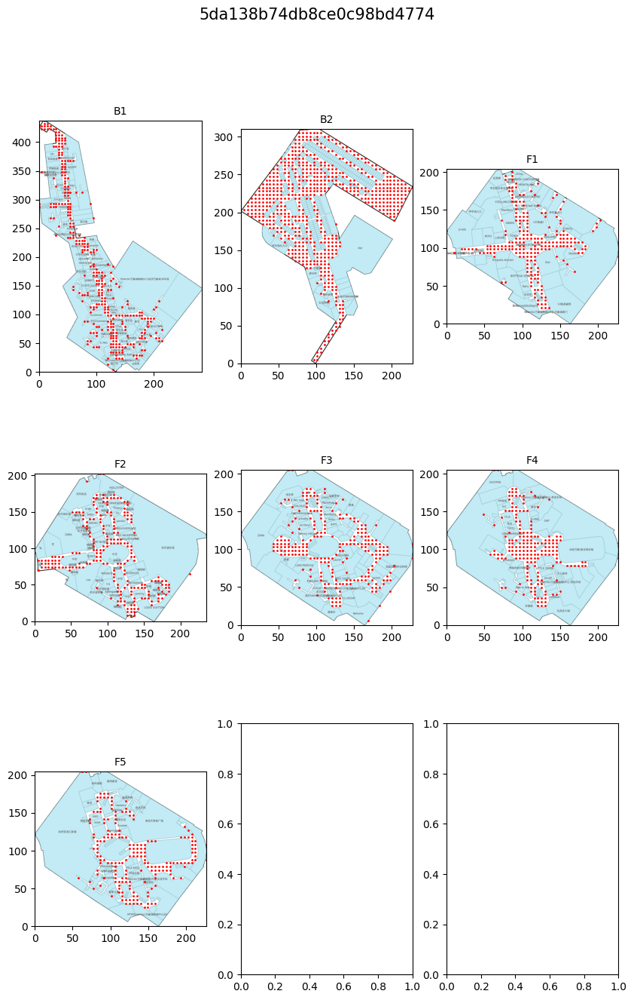

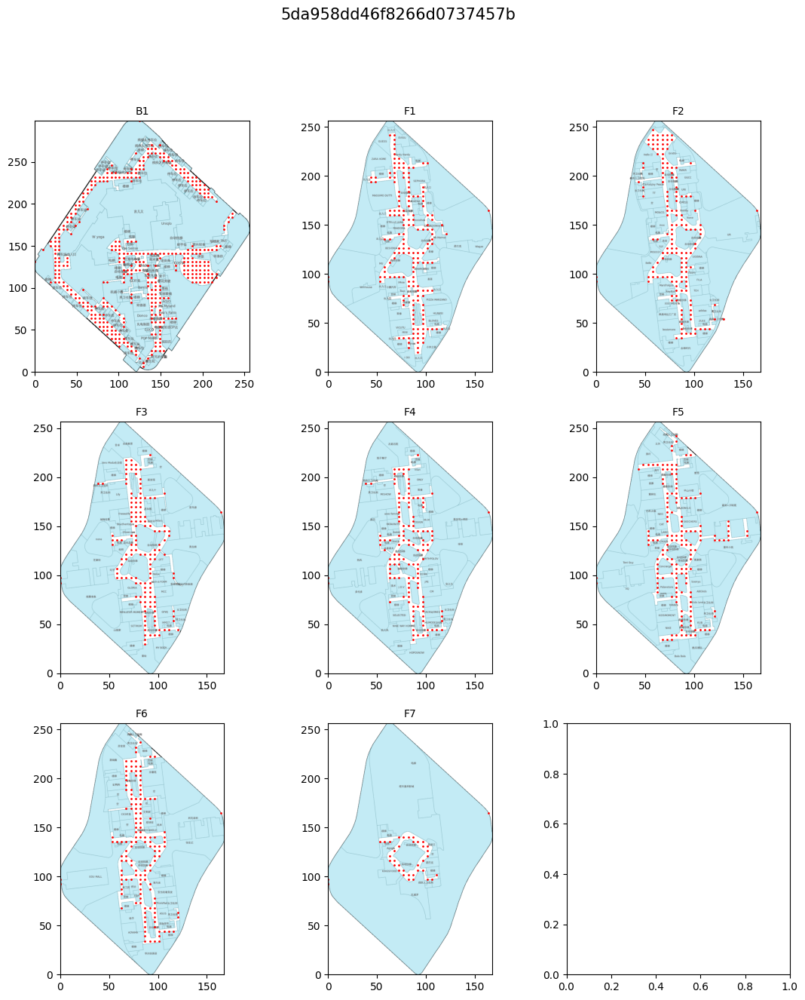

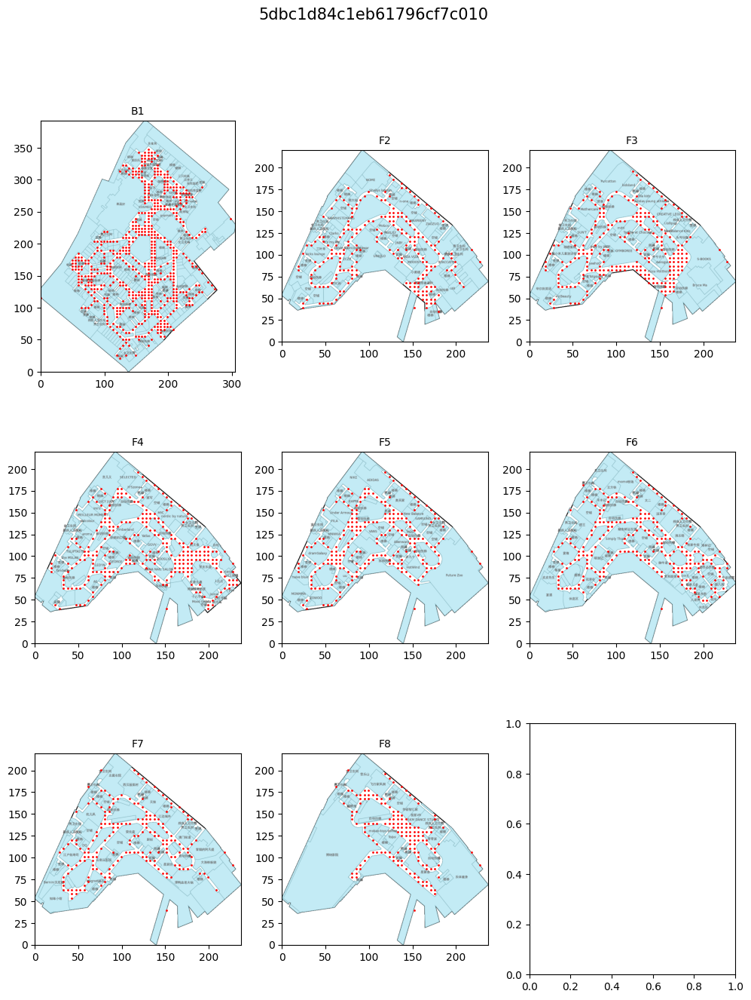

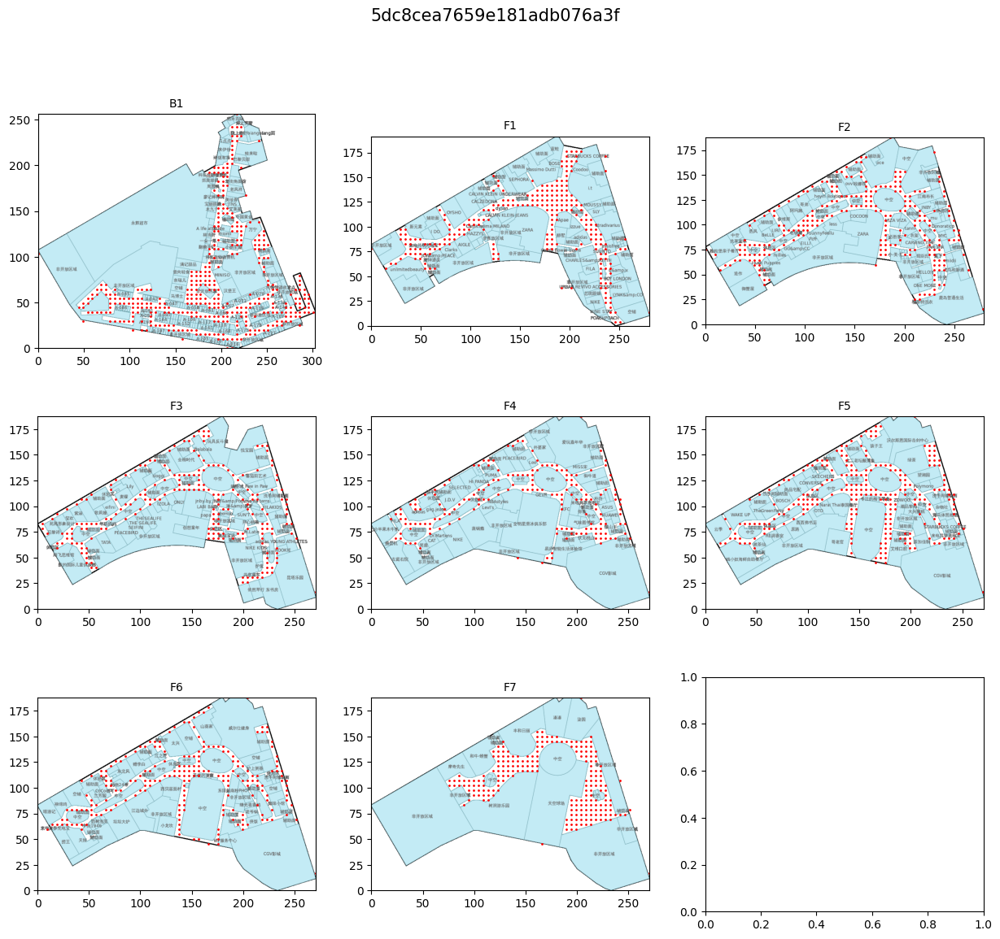

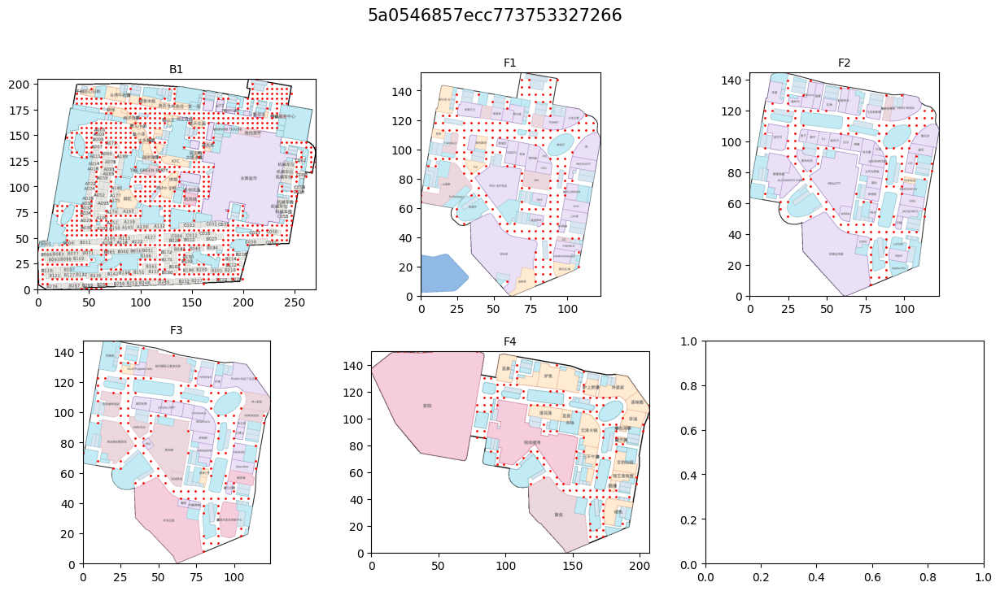

...

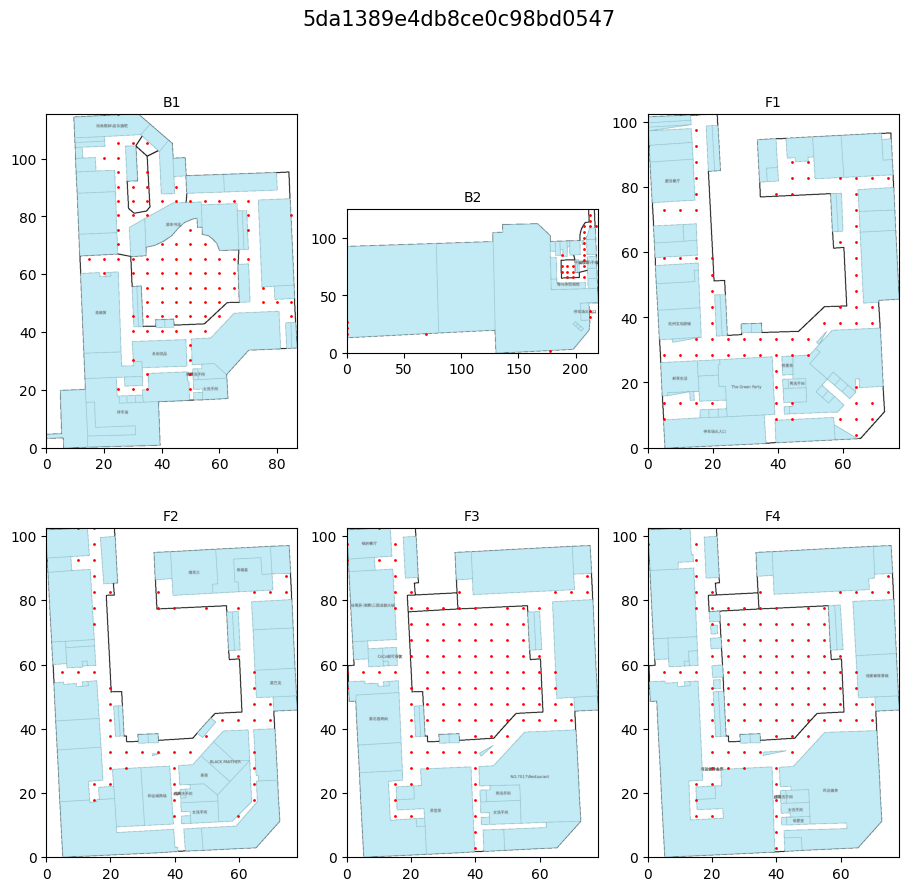

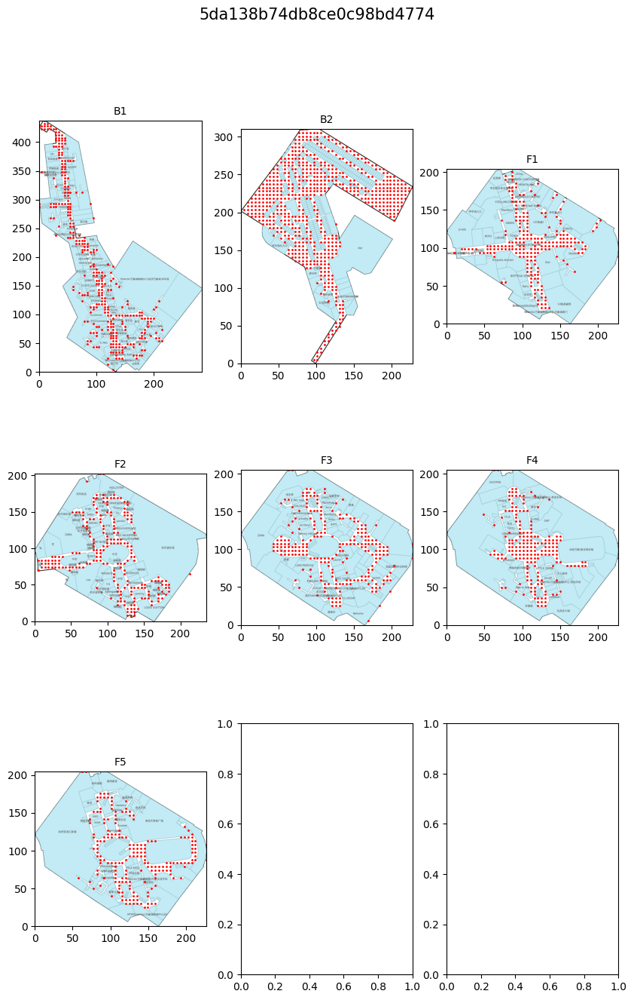

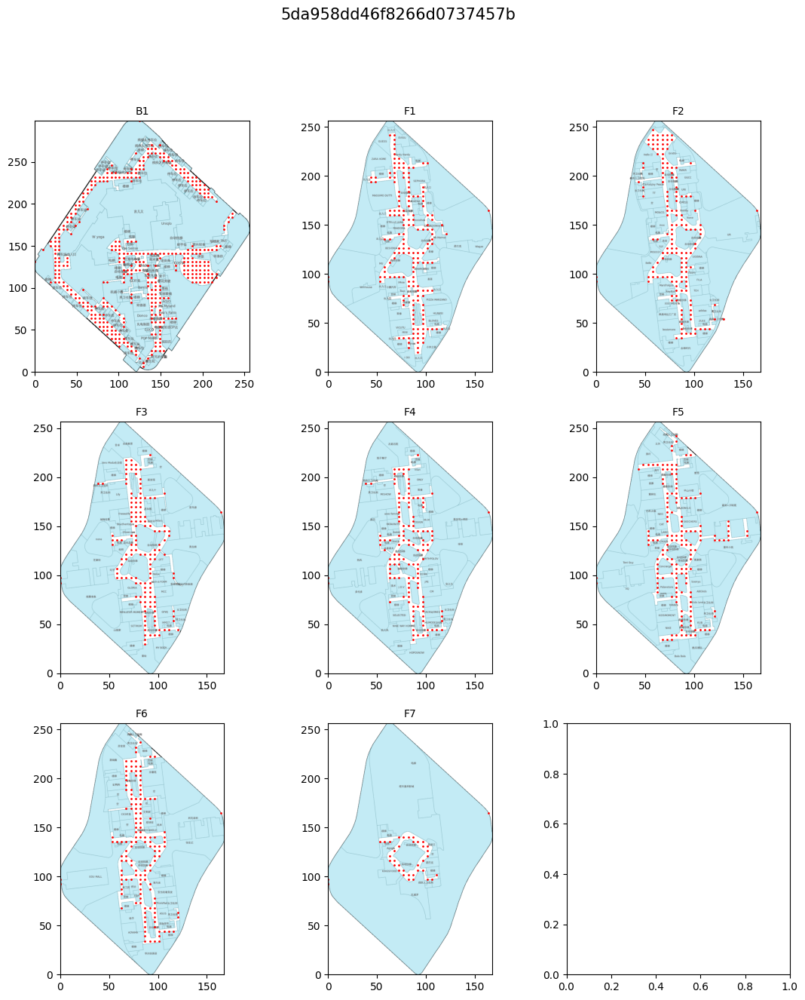

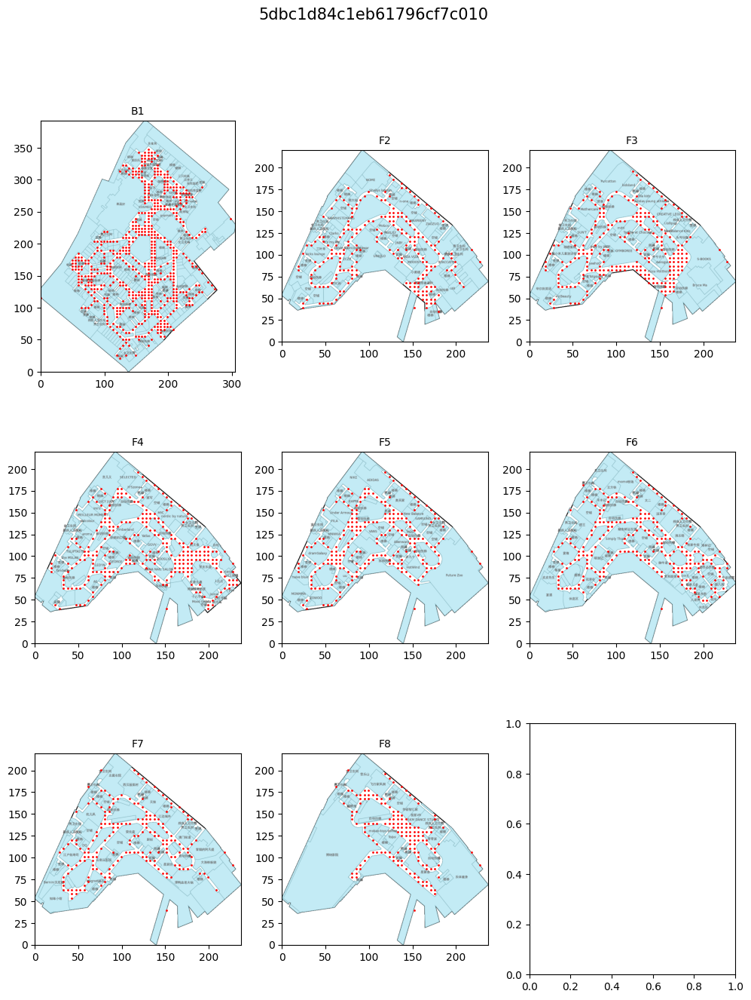

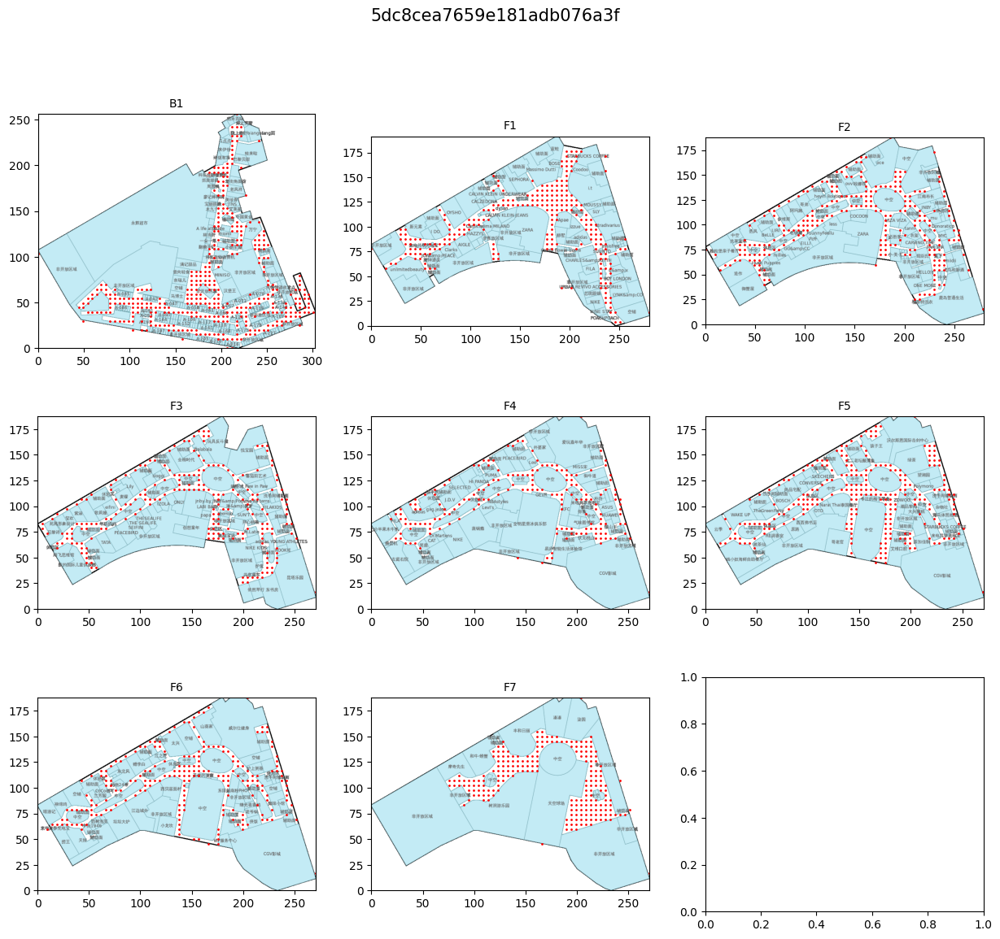

In [764]:
dpi = 100
length_m = 5

site_unique = sorted(np.unique(site_arr))

for site in site_unique:
    floor_list = sorted(glob(f'{dir_image}{site}/*'))
    floor_list = [text.split('/')[-1] for text in floor_list]

    path_json = f'./../data_ignore/input/metadata/{site}/{floor_list[0]}/floor_info.json'
    with open(path_json) as json_file:
        json_data = json.load(json_file)
    _width_meter = json_data["map_info"]["width"]
    _height_meter = json_data["map_info"]["height"]
    s = max(_width_meter, _height_meter)

    n_floor = len(floor_list)
    n_row = int(np.ceil(n_floor / 3))
    w = round(5*3*_width_meter/s)
    h = round(5*n_row*_height_meter/s)
    fig, axs = plt.subplots(n_row, 3, figsize=(w, h), dpi=dpi)
    fig.suptitle(site, fontsize=15)
    fig.patch.set_facecolor('white')
    axs = axs.ravel()

    for i_floor, floor in enumerate(floor_list):
        # json
        path_json = f'./../data_ignore/input/metadata/{site}/{floor}/floor_info.json'
        with open(path_json) as json_file:
            json_data = json.load(json_file)
        width_meter = json_data["map_info"]["width"]
        height_meter = json_data["map_info"]["height"]

        # show image
        path_img = f'{dir_image}{site}/{floor}/floor_image.png'
        img_ori, img_gray, _x, _y = get_extra_grid(path_img, width_meter, height_meter, length_m=length_m)
#         img_w, img_h = img_ori.shape[:2]
        h_scale = height_meter/img_gray.shape[0]  # 1pxあたりのスケール
        w_scale = width_meter/img_gray.shape[1]  # 1pxあたりのスケール
        
        _x = _x*w_scale
        _y = _y*h_scale
        axs[i_floor].imshow(np.asarray(img_ori), extent=(0, width_meter, 0, height_meter))
#         axs[i_floor].imshow(np.asarray(img_ori), extent=(0, width_meter, height_meter, 0))
        axs[i_floor].scatter(_x, _y, color='r', s=1)
        axs[i_floor].set_title(floor, fontsize=10)

    display(fig)